# Imports

In [ ]:
import shutil
import json

from mmocr.apis import MMOCRInferencer

from PIL import Image
import numpy as np
import pandas as pd

# Setup

In [4]:
mmocr_dir = '../mmocr/configs'
det_weights = f'{mmocr_dir}/textdet/dbnet/dbnet_resnet50-oclip_1200e_icdar2015_20221102_115917-bde8c87a.pth'
rec_conf = f'{mmocr_dir}/textrecog/svtr/svtr-small_20e_st_mj.py'
rec_weights = f'{mmocr_dir}/textrecog/svtr/svtr-small_20e_st_mj-35d800d6.pth'
config_dict = {
    'det': 'DBNet', 'det_weights': det_weights,
    'rec': rec_conf, 'rec_weights': rec_weights, }
ocr = MMOCRInferencer(**config_dict)

Loads checkpoint by local backend from path: ../mmocr/configs/textdet/dbnet/dbnet_resnet50-oclip_1200e_icdar2015_20221102_115917-bde8c87a.pth


C:\Users\leona\miniconda3\envs\demo_v4\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


10/26 22:17:39 - mmengine - WARNING - Failed to search registry with scope "mmocr" in the "function" registry tree. As a workaround, the current "function" registry in "mmengine" is used to build instance. This may cause unexpected failure when running the built modules. Please check whether "mmocr" is a correct scope, or whether the registry is initialized.
10/26 22:17:39 - mmengine - WARNING - `Visualizer` backend is not initialized because save_dir is None.
Loads checkpoint by local backend from path: ../mmocr/configs/textrecog/svtr/svtr-small_20e_st_mj-35d800d6.pth


# Image

In [5]:
# input
img_path = "../mmocr/demo/demo_text_ocr.jpg"
img_path = "./input.png"

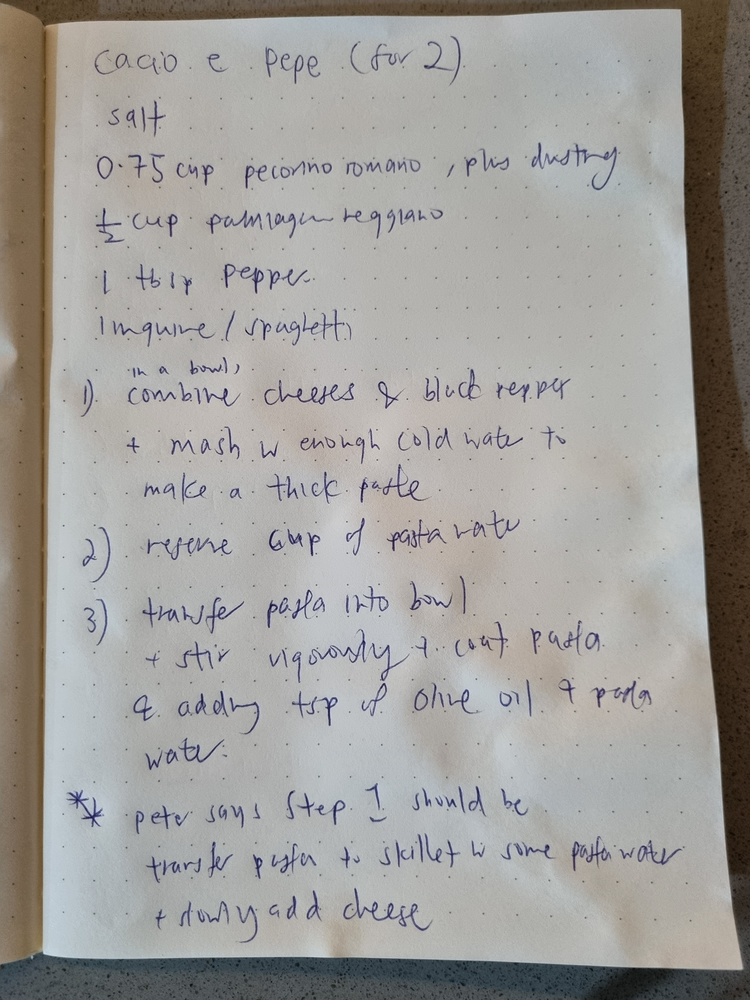

In [6]:
img_read = Image.open(img_path)
img_read

# Inference

In [7]:
ocr_prediction = ocr(img_path, print_result=False, show=False, return_vis=True)

C:\Users\leona\miniconda3\envs\demo_v4\lib\site-packages\rich\live.py:231: UserWarning: install "ipywidgets" for 
Jupyter support
  warnings.warn('install "ipywidgets" for Jupyter support')

In [8]:
list(ocr_prediction)

['predictions', 'visualization']

## Visualisation

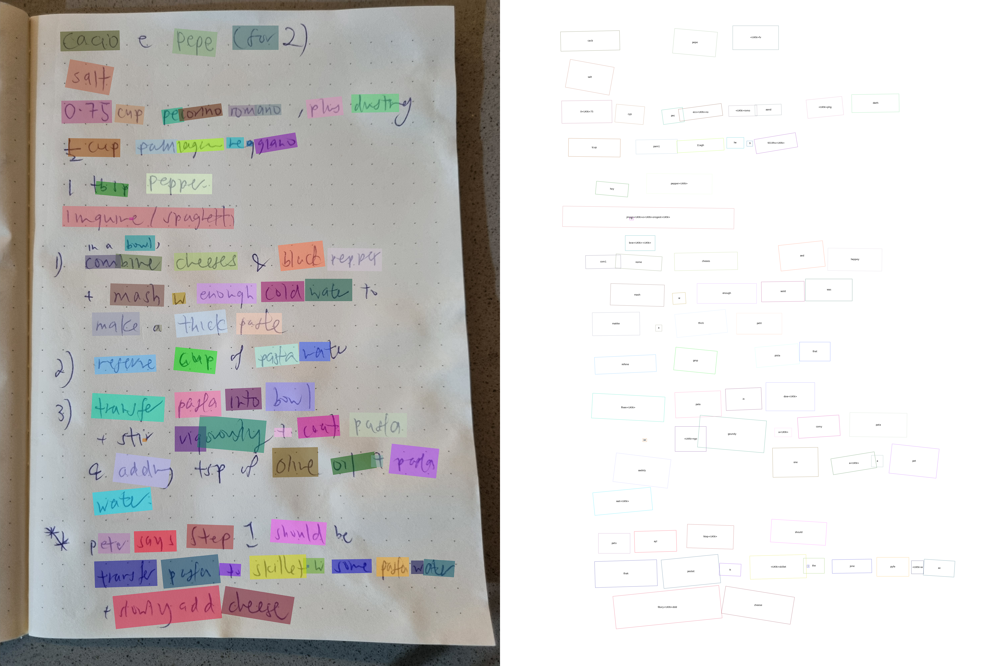

In [9]:
img = Image.fromarray(ocr_prediction['visualization'][0], 'RGB')
img

## Predictions

In [10]:
list(ocr_prediction['predictions'][0])

['rec_texts', 'rec_scores', 'det_polygons', 'det_scores']

In [11]:
for idx, det_polygon in enumerate(ocr_prediction['predictions'][0]['det_polygons']):
    print(idx, det_polygon)

0 [676.0407239198685, 3581.8348643543954, 1311.748445034027, 3516.0560468177655, 1331.95298910141, 3711.41361893315, 696.2453126907349, 3777.1924364697798]
1 [1327.2374868392944, 3682.9638135302193, 1353.4440994262695, 3520.4423506181315, 1766.5568590164185, 3587.0897006639193, 1740.3502464294434, 3749.611163576007]
2 [566.0973340272903, 3372.993933150183, 938.8983249664307, 3361.4611950549447, 943.7370300292969, 3517.9522951007325, 570.9360837936401, 3529.4850331959706]
3 [1839.84375, 3408.0586080586077, 1839.84375, 3393.4065934065934, 1854.4921875, 3393.4065934065934, 1854.4921875, 3408.0586080586077]
4 [1313.7661814689636, 3454.726848672161, 1317.2194361686707, 3382.1893601190473, 1445.9733366966248, 3388.322029532967, 1442.5200819969177, 3460.8595180860802]
5 [965.5786156654358, 3363.6378920558604, 1306.4085245132446, 3329.546917925824, 1323.493480682373, 3500.4389165521975, 982.6635718345642, 3534.529890682234]
6 [2538.3766293525696, 3454.0725875686812, 2544.6261763572693, 3358.22

In [12]:
ocr_prediction['predictions'][0]['det_scores']

[0.7616796493530273,
 0.8901824951171875,
 0.8772602677345276,
 0.3370114266872406,
 0.5015895962715149,
 0.8498162031173706,
 0.8737082481384277,
 0.7437669634819031,
 0.8243215084075928,
 0.8898550271987915,
 0.6041953563690186,
 0.8669888973236084,
 0.8523603677749634,
 0.7874609231948853,
 0.8602949976921082,
 0.9253827929496765,
 0.8676116466522217,
 0.8220146298408508,
 0.5405135154724121,
 0.43131521344184875,
 0.8941373825073242,
 0.8450223803520203,
 0.3471396863460541,
 0.7893065810203552,
 0.39191704988479614,
 0.8947239518165588,
 0.6823142170906067,
 0.8639261722564697,
 0.9172605276107788,
 0.8885860443115234,
 0.8913396000862122,
 0.840394139289856,
 0.8280842304229736,
 0.7980252504348755,
 0.8990561366081238,
 0.7595795392990112,
 0.394987553358078,
 0.889806866645813,
 0.7199422717094421,
 0.9035533666610718,
 0.47540417313575745,
 0.900040864944458,
 0.8283922076225281,
 0.9133708477020264,
 0.842551052570343,
 0.8664591312408447,
 0.8319657444953918,
 0.927088081836

In [13]:
ocr_prediction['predictions'][0]['rec_texts']

['fdury<UKN>ddd',
 'cheese',
 'thak',
 'i',
 'is',
 'pestet',
 'av',
 '<UKN>w',
 'jone',
 'pyfe',
 'the',
 '<UKN>skillet',
 'petv',
 'ayl',
 'htep<UKN>',
 'should',
 'wat<UKN>',
 'aadoly',
 'a<UKN>',
 'a',
 'one',
 'pet',
 'oe',
 '<UKN>ngo',
 'a<UKN>',
 'goundy',
 'comy',
 'pata',
 'fhwe<UKN>',
 'pala',
 'in',
 'dow<UKN>',
 'refene',
 'gmp',
 'pista',
 'that',
 'a',
 'makke',
 'pehl',
 'thick',
 'w',
 'mash',
 'enough',
 'wold',
 'was',
 'nome',
 'com1',
 'cheees',
 'heppey',
 'aed',
 'bvw<UKN><UKN>',
 'a',
 'jmgan<UKN>e<UKN>orogest<UKN>',
 'hoy',
 'pepper<UKN>',
 'pam1',
 'tcup',
 '9',
 '11agh',
 '9319hs<UKN>',
 'he',
 'pec',
 'cyp',
 'eco<UKN>no',
 '<UKN>romo',
 'aand',
 '0<UKN>75',
 '<UKN>phg',
 'dwth',
 'salt',
 'cacb',
 'pepe',
 '<UKN>fv']

In [14]:
ocr_prediction['predictions'][0]['rec_scores']

[0.8084680835405985,
 0.9011030594507853,
 0.8042657673358917,
 0.23535731434822083,
 0.30813679099082947,
 0.5465656071901321,
 0.8464741110801697,
 0.7217266261577606,
 0.9481634944677353,
 0.5553008243441582,
 0.7748633225758871,
 0.7433311678469181,
 0.8995371907949448,
 0.4360351512829463,
 0.8346749365329742,
 0.8821629087130228,
 0.8515253663063049,
 0.6596456269423167,
 0.344319611787796,
 0.4256950914859772,
 0.9689371983210245,
 0.5843405475219091,
 0.26395290344953537,
 0.5288983881473541,
 0.4978201687335968,
 0.678988441824913,
 0.6273612901568413,
 0.8677983283996582,
 0.5204226851463318,
 0.6646968647837639,
 0.7051059305667877,
 0.6052353754639626,
 0.833197663227717,
 0.9273359378178915,
 0.606094217300415,
 0.9550402462482452,
 0.9792280197143555,
 0.8559357821941376,
 0.6842432990670204,
 0.9379819869995117,
 0.836400032043457,
 0.9732934385538101,
 0.9975549976030985,
 0.7294135466217995,
 0.4877598484357198,
 0.6869594603776932,
 0.8424596786499023,
 0.762094338734

# Post-process

In [15]:
def preprocess_ocr_format(ocr_prediction_df):
    # merge
    text_boxes_lst = []
    for idx, row in ocr_prediction_df.iterrows():
        raw_text = row['rec_texts']
        ocr_texts = raw_text.replace('<UKN>', '').strip()
        if ocr_texts == '':
            continue
        text_boxes_lst.append({
            'text': ocr_texts,
            'box': row['det_polygons'],
        })
    return text_boxes_lst

In [16]:
def is_on_same_line(box_a, box_b, min_y_overlap_ratio=0.8):
    """Check if two boxes are on the same line by their y-axis coordinates.
    Two boxes are on the same line if they overlap vertically, and the length
    of the overlapping line segment is greater than min_y_overlap_ratio * the
    height of either of the boxes.
    Args:
        box_a (list), box_b (list): Two bounding boxes to be checked
        min_y_overlap_ratio (float): The minimum vertical overlapping ratio
                                    allowed for boxes in the same line
    Returns:
        The bool flag indicating if they are on the same line
    """
    a_y_min = np.min(box_a[1::2])
    b_y_min = np.min(box_b[1::2])
    a_y_max = np.max(box_a[1::2])
    b_y_max = np.max(box_b[1::2])

    # Make sure that box a is always the box above another
    if a_y_min > b_y_min:
        a_y_min, b_y_min = b_y_min, a_y_min
        a_y_max, b_y_max = b_y_max, a_y_max

    if b_y_min <= a_y_max:
        if min_y_overlap_ratio is not None:
            sorted_y = sorted([b_y_min, b_y_max, a_y_max])
            overlap = sorted_y[1] - sorted_y[0]
            min_a_overlap = (a_y_max - a_y_min) * min_y_overlap_ratio
            min_b_overlap = (b_y_max - b_y_min) * min_y_overlap_ratio
            return overlap >= min_a_overlap or \
                overlap >= min_b_overlap
        else:
            return True
    return False

In [17]:
def stitch_boxes_into_lines(boxes, max_x_dist=20, min_y_overlap_ratio=0.5):

    """Stitch fragmented boxes of words into lines.
    Note: part of its logic is inspired by @Johndirr
    (https://github.com/faustomorales/keras-ocr/issues/22)
    Args:
        boxes (list): List of ocr results to be stitched
        max_x_dist (int): The maximum horizontal distance between the closest
                    edges of neighboring boxes in the same line
        min_y_overlap_ratio (float): The minimum vertical overlapping ratio
                    allowed for any pairs of neighboring boxes in the same line
    Returns:
        merged_boxes(list[dict]): List of merged boxes and texts
    """


    if len(boxes) <= 1:
        return boxes

    merged_boxes = []

    # sort groups based on the x_min coordinate of boxes
    x_sorted_boxes = sorted(boxes, key=lambda x: np.min(x['box'][::2]))
    # store indexes of boxes which are already parts of other lines
    skip_idxs = set()

    i = 0
    # locate lines of boxes starting from the leftmost one
    for i in range(len(x_sorted_boxes)):
        if i in skip_idxs:
            continue
        # the rightmost box in the current line
        rightmost_box_idx = i
        line = [rightmost_box_idx]
        for j in range(i + 1, len(x_sorted_boxes)):
            if j in skip_idxs:
                continue
            if is_on_same_line(x_sorted_boxes[rightmost_box_idx]['box'],
                               x_sorted_boxes[j]['box'], min_y_overlap_ratio):
                line.append(j)
                skip_idxs.add(j)
                rightmost_box_idx = j

        # split line into lines if the distance between two neighboring
        # sub-lines' is greater than max_x_dist
        lines = []
        line_idx = 0
        lines.append([line[0]])
        for k in range(1, len(line)):
            curr_box = x_sorted_boxes[line[k]]
            prev_box = x_sorted_boxes[line[k - 1]]
            dist = np.min(curr_box['box'][::2]) - np.max(prev_box['box'][::2])
            if dist > max_x_dist:
                line_idx += 1
                lines.append([])
            lines[line_idx].append(line[k])

        # Get merged boxes
        for box_group in lines:
            merged_box = {}
            merged_box['text'] = ' '.join(
                [x_sorted_boxes[idx]['text'] for idx in box_group])
            x_min, y_min = float('inf'), float('inf')
            x_max, y_max = float('-inf'), float('-inf')
            for idx in box_group:
                x_max = max(np.max(x_sorted_boxes[idx]['box'][::2]), x_max)
                x_min = min(np.min(x_sorted_boxes[idx]['box'][::2]), x_min)
                y_max = max(np.max(x_sorted_boxes[idx]['box'][1::2]), y_max)
                y_min = min(np.min(x_sorted_boxes[idx]['box'][1::2]), y_min)
            merged_box['box'] = [
                x_min, y_min, x_max, y_min, x_max, y_max, x_min, y_max
            ]
            merged_boxes.append(merged_box)

    return merged_boxes

In [18]:
def postprocess_ocr_format(merged_boxes):
    ocr_text_lst = []
    for merged_details in merged_boxes:
        current_text = merged_details['text']
        ocr_text_lst.append(current_text)
    
    # merge to texts
    ocr_text = '\n'.join(ocr_text_lst)

    return ocr_text

In [19]:
ocr_prediction_df = pd.DataFrame(ocr_prediction['predictions'][0])
ocr_prediction_df

,rec_texts,rec_scores,det_polygons,det_scores
0,fdury<UKN>ddd,0.808468,"[676.0407239198685, 3581.8348643543954, 1311.7...",0.761680
1,cheese,0.901103,"[1327.2374868392944, 3682.9638135302193, 1353....",0.890182
2,thak,0.804266,"[566.0973340272903, 3372.993933150183, 938.898...",0.877260
3,i,0.235357,"[1839.84375, 3408.0586080586077, 1839.84375, 3...",0.337011
4,is,0.308137,"[1313.7661814689636, 3454.726848672161, 1317.2...",0.501590
...,...,...,...,...
68,dwth,0.644420,"[2108.688712120056, 569.2067575978708, 2392.75...",0.816557
69,salt,0.968959,"[390.72659611701965, 524.4717887906364, 421.05...",0.908096
70,cacb,0.909297,"[361.7921322584152, 192.29231055402929, 715.98...",0.879056
71,pepe,0.996047,"[1034.0295732021332, 319.92382007640794, 1047....",0.903469


In [20]:
# merge
text_boxes_lst = preprocess_ocr_format(ocr_prediction_df)

# stitch
merged_boxes = stitch_boxes_into_lines(text_boxes_lst,
                                       max_x_dist = 800,
                                       min_y_overlap_ratio = 0.5)

# extract the text
ocr_text = postprocess_ocr_format(merged_boxes)

In [21]:
print(ocr_text)

cacb pepe fv
075 cyp pec econo romo aand phg dwth
jmganeorogest a
salt
tcup pam1 11agh he 9 9319hs
com1 nome cheees aed heppey
fhwe pala in dow
makke a thick pehl
wat
refene gmp pista that
thak pestet is skillet the i jone pyfe w av
hoy pepper
petv ayl htep should
mash w enough wold was
fduryddd cheese
aadoly one a a pet
bvw
oe ngo goundy a comy pata
